In [3]:
# Sources:
# https://importchris.medium.com/how-to-create-understand-mel-spectrograms-ff7634991056
# https://www.perplexity.ai/search/What-are-currently-9HerWacvSry5Rti86f4psA
import librosa, librosa.display
from musicnet.utils import Track, notes_vocab, instruments_vocab
from musicnet.preprocessing.midi_to_wav.utils import MidiConvertedTrack, get_midi_train_ids
from musicnet.preprocessing.wav_specs_and_notes.utils import Preprocessor, load_params
import IPython.display as ipd
from matplotlib import pyplot as plt
import numpy as np
from numpy.fft import rfftfreq

In [4]:
instruments_vocab

{1: 0, 7: 1, 41: 2, 42: 3, 43: 4, 44: 5, 61: 6, 69: 7, 71: 8, 72: 9, 74: 10}

In [20]:
params = load_params()
params["preprocessor"]["n_fft"] = 2205
params["preprocessor"]["hop_length"] = 441
params["preprocessor"]["target_sr"] = 44100

In [21]:
id = get_midi_train_ids()[-1]
track = MidiConvertedTrack(id)
print(id)
print(track.metadata)

2477
composer                           Beethoven
composition     Piano Sonata No 3 in C major
movement                 3. Scherzo: Allegro
ensemble                          Solo Piano
source                     Glen W. Prillaman
transcriber                    piano-midi.de
catalog_name                          OP2NO3
seconds                                  220
Name: 2477, dtype: object


In [22]:
sr = params["preprocessor"]["target_sr"]
signal = track.read_wav_data(sr)
print(sr)

44100


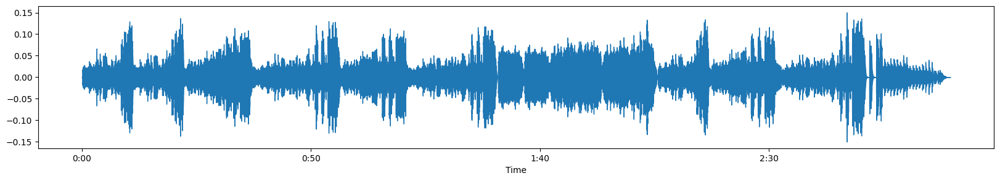

In [23]:
plt.figure(figsize=(20, 3))
librosa.display.waveshow(signal, sr=sr)

In [24]:
ipd.Audio(signal, rate=sr)

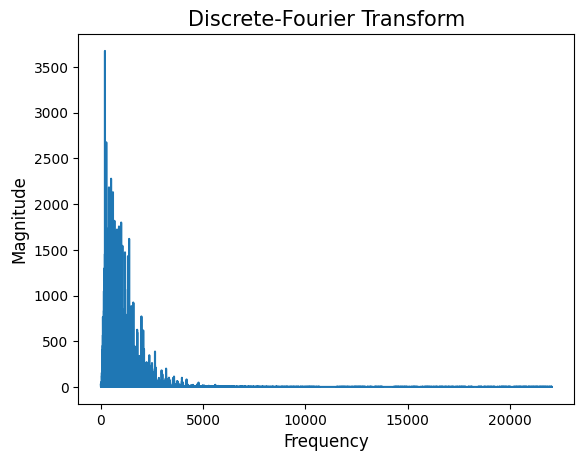

In [25]:
# Creating a Discrete-Fourier Transform with our FFT algorithm
fast_fourier_transf = np.fft.fft(signal)
# Magnitudes indicate the contribution of each frequency
magnitude = np.abs(fast_fourier_transf)
# mapping the magnitude to the relative frequency bins
frequency = np.linspace(0, sr, len(magnitude))
# We only need the first half of the magnitude and frequency
left_mag = magnitude[:int(len(magnitude)/2)]
left_freq = frequency[:int(len(frequency)/2)]

plt.plot(left_freq, left_mag)
plt.title("Discrete-Fourier Transform", fontdict=dict(size=15))
plt.xlabel("Frequency", fontdict=dict(size=12))
plt.ylabel("Magnitude", fontdict=dict(size=12))
plt.show()

In [26]:
# this is the number of samples in a window per fft (25 ms)
n_fft = params["preprocessor"]["n_fft"]
# The amount of samples we are shifting after each fft (10 ms)
hop_length = params["preprocessor"]["hop_length"]
# Short-time Fourier Transformation on our audio data
audio_stft = librosa.core.stft(signal, hop_length=hop_length, n_fft=n_fft)
# gathering the absolute values for all values in our audio_stft
spectrogram = np.abs(audio_stft)
# Converting the amplitude to decibels (20 * log10(amplitude))
log_spectro = librosa.amplitude_to_db(spectrogram, amin=1e-10)

In [27]:
log_spectro.shape

(1103, 18965)

In [28]:
Z = spectrogram[:, :(sr // hop_length) * 10]
Z.shape

(1103, 1000)

In [29]:
Y = rfftfreq(n_fft, 1.0 / sr)
Y = Y[Y < 4000]
y_ticks = Y
Z = Z[:len(Y), :]
print(y_ticks.shape, Y.shape, Z.shape)

(200,) (200,) (200, 1000)


In [30]:
# rfftfreq(2205, 1.0 / sr)[:10]

In [31]:
X = np.arange(Z.shape[1])
X, Y = np.meshgrid(X, Y)

In [32]:
print(X.shape, Y.shape, Z.shape)

(200, 1000) (200, 1000) (200, 1000)


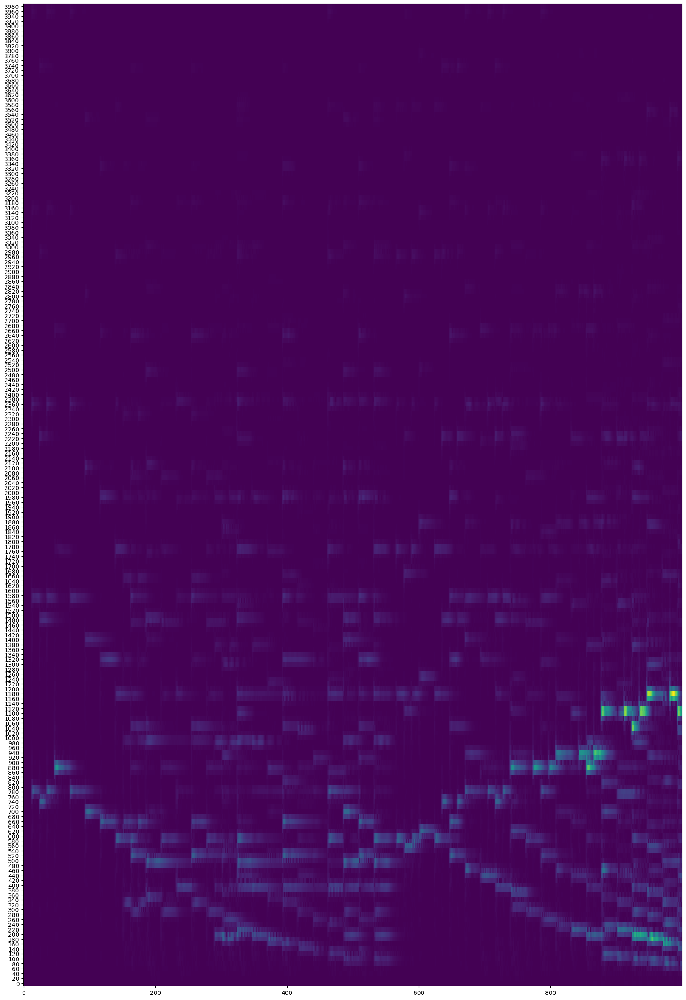

In [33]:
plt.figure(figsize=(20, 30))
plt.pcolormesh(X, Y, Z)
plt.yticks(y_ticks)
plt.show()

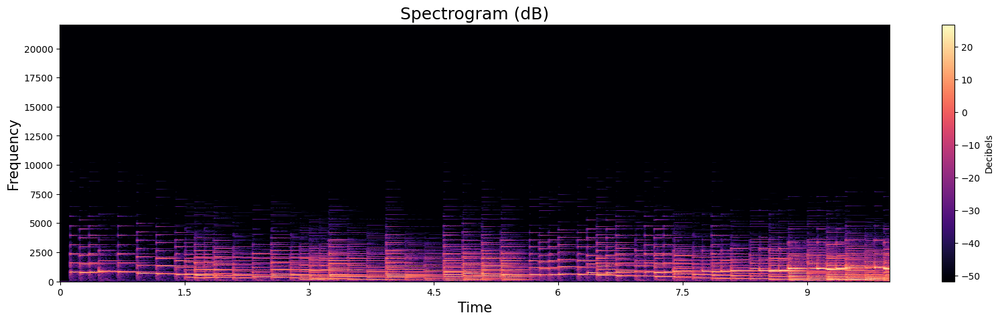

In [34]:
# Plotting the short-time Fourier Transformation
plt.figure(figsize=(20, 5))
# Using librosa.display.specshow() to create our spectrogram
librosa.display.specshow(
    log_spectro[:, :(sr // hop_length) * 10],
    sr=sr,
    x_axis="time",
    y_axis="hz",
    hop_length=hop_length,
)
plt.colorbar(label="Decibels")
plt.title("Spectrogram (dB)", fontdict=dict(size=18))
plt.xlabel("Time", fontdict=dict(size=15))
plt.ylabel("Frequency", fontdict=dict(size=15))
plt.show()

In [231]:
def display_melspec(limit_s, sr, hop_length, n_fft):
    signal = track.read_wav_data(sr)
    mel_signal = librosa.feature.melspectrogram(
        y=signal[:sr*limit_s],
        sr=sr,
        hop_length=hop_length,
        n_fft=n_fft,
        n_mels=100,
        fmax=4096,
        power=2
    )
    spectrogram = np.abs(mel_signal)
    power_to_db = librosa.power_to_db(spectrogram)
    print(spectrogram.shape)
    librosa.display.specshow(
        power_to_db,
        sr=sr,
        x_axis="time",
        y_axis="mel",
        hop_length=hop_length,
        fmax=4096
    )
    plt.set_cmap("grey")
    plt.colorbar()
    plt.title('Mel-Spectrogram (dB)', fontdict=dict(size=18))
    plt.xlabel('Time', fontdict=dict(size=15))
    plt.ylabel('Frequency', fontdict=dict(size=15))

(100, 10023)
(100, 1001)


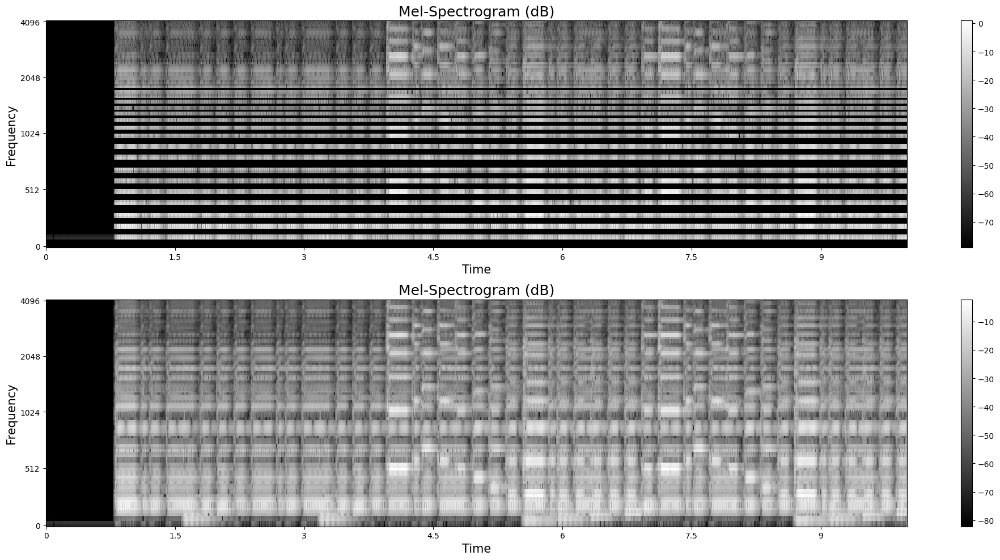

In [236]:
plt.figure(figsize=(20, 10))
plt.subplot(2, 1, 1)
display_melspec(10, 44100, 44, 440)
plt.subplot(2, 1, 2)
display_melspec(10, 16000, 160, 400)
plt.tight_layout()
plt.show()